In [185]:
import warnings
warnings.filterwarnings("ignore")

import numpy as np
import gstools as gs
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
import pandas as pd
from sklearn.cluster import KMeans



#line continuous
from sklearn.preprocessing import KBinsDiscretizer
from hmmlearn import hmm
from sklearn.metrics import silhouette_score


# 模拟数据生成
x = np.linspace(0, 25, 25)
y = np.linspace(0, 25, 25)
XX, YY = np.meshgrid(x, y)
model = gs.Gaussian(dim=2, var=1, len_scale=3)
srf = gs.SRF(model, mean=0.)
B0 = srf((x, y), mesh_type='structured', seed=100)



In [186]:
times = 1001
threshold = 1e-5
dimensionxy = 25
n_states = 5
X = np.linspace(0, 25, 25)
Y = np.linspace(0, 25, 25)
XX, YY = np.meshgrid(X, Y)

# 使用一些模拟数据
model = gs.Gaussian(dim=2, var=1, len_scale=3)
srf = gs.SRF(model, mean=0.)
B0 = srf((X, Y), mesh_type='structured', seed=100)

LLNtype = ["field-continuous", "field-discrete", "line-continuous", "line-discrete","point-continuous"]


n_states = 5
est = KBinsDiscretizer(n_bins=n_states, encode='ordinal', strategy='uniform')

# 带有随机性的处理数据函数
def process_data_with_randomness_field_continuous(X_train, X_test, y_train, y_test):
    rf = RandomForestRegressor(n_estimators=100)
    rf.fit(X_train, y_train)
    y_pred = rf.predict(X_test)
    mse = mean_squared_error(y_test, y_pred)

    y_pred_full = rf.predict(X).reshape(XX.shape)
    y_pred_full_column = y_pred_full.ravel()
    return y_pred_full_column

# 带有随机性的处理数据函数，使用 KMeans 聚类并计算簇内平方和（Inertia）
def process_data_with_randomness_field_discrete(data):
    kmeans = KMeans(n_clusters=4, n_init=10, random_state=None)  # 这里增加了 n_init 参数
    kmeans.fit(data)
    labels = kmeans.labels_
    return labels

def process_data_with_randomness_line_continuous(B_discretized):
    # 构建转移概率矩阵
    transition_matrix = np.zeros((n_states, n_states))
    for month in range(dimensionxy-1):  # 24次状态转移
        for day in range(dimensionxy):
            current_state = int(B_discretized[month, day])
            next_state = int(B_discretized[month + 1, day])
            transition_matrix[current_state, next_state] += 1
    # 归一化转移概率矩阵
    transition_matrix /= transition_matrix.sum(axis=1, keepdims=True)
    # 使用马尔可夫链预测第26个月的状态
    last_month_states = B_discretized[-1, :]
    predicted_states = []

    for state in last_month_states:
        predicted_state = np.random.choice(np.arange(n_states), p=transition_matrix[int(state)])
        predicted_states.append(predicted_state)
    B26_pred = est.inverse_transform([predicted_states])
    predicted_value=B26_pred.flatten()
    return predicted_value

def process_data_with_randomness_line_discrete(B_discretized, n_states=5, dimensionxy=25):
    model = hmm.MultinomialHMM(n_components=n_states, n_iter=100, random_state=None)  # random_state 设置为 None 增加随机性
    sequence = B_discretized[:dimensionxy, :].reshape(-1, 1)
    model.fit(sequence)
    log_likelihood = model.score(sequence)  # 计算对数似然

    # 预测第26行的状态
    predicted_states = []
    for day in range(dimensionxy):
        last_state = B_discretized[-1, day]
        next_state_probabilities = model.transmat_[int(last_state)]
        predicted_state = np.random.choice(np.arange(n_states), p=next_state_probabilities)
        predicted_states.append(predicted_state)

    return log_likelihood

def process_data_with_randomness_point_continuous(B_discretized, row_index, col_index):
    # 构建转移概率矩阵
    n_states=5
    transition_matrix = np.zeros((n_states, n_states))

    for month in range(24):  # 24次状态转移
        current_state = int(B_discretized[month, col_index])
        next_state = int(B_discretized[month + 1, col_index])
        transition_matrix[current_state, next_state] += 1

    # 归一化转移概率矩阵
    transition_matrix /= transition_matrix.sum(axis=1, keepdims=True)

    # 使用马尔可夫链预测指定位置的下一个状态
    last_state = int(B_discretized[row_index, col_index])
    predicted_state = np.random.choice(np.arange(n_states), p=transition_matrix[last_state])

    # 将预测的状态扩展到整个特征维度
    dummy_states = np.full((1, B_discretized.shape[1]), fill_value=-1)
    dummy_states[0, col_index] = predicted_state

    # 将预测的状态转换回实际值范围
    predicted_values = est.inverse_transform(dummy_states)
    predicted_value = predicted_values[0, col_index]

    print(f"Predicted value for position ({row_index}, {col_index}): {predicted_value}")
    return predicted_value

In [187]:
# 运行代码





field-continuous
break 3
previous_mean_array 4
field-discrete
break 2


MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows

previous_mean_array 3
line-continuous
previous_mean_array 3
line-discrete
break 2


MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows

previous_mean_array 3
point-continuous
Predicted value for position (24, 9): -0.8842550909756126
Predicted value for position (24, 9): -0.8842550909756126
break 2
Predicted value for position (24, 9): -0.8842550909756126
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): -0.8842550909756126
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): -0.8842550909756126
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): -0.8842550909756126
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): -0.8842550909756126
Predicted value for position

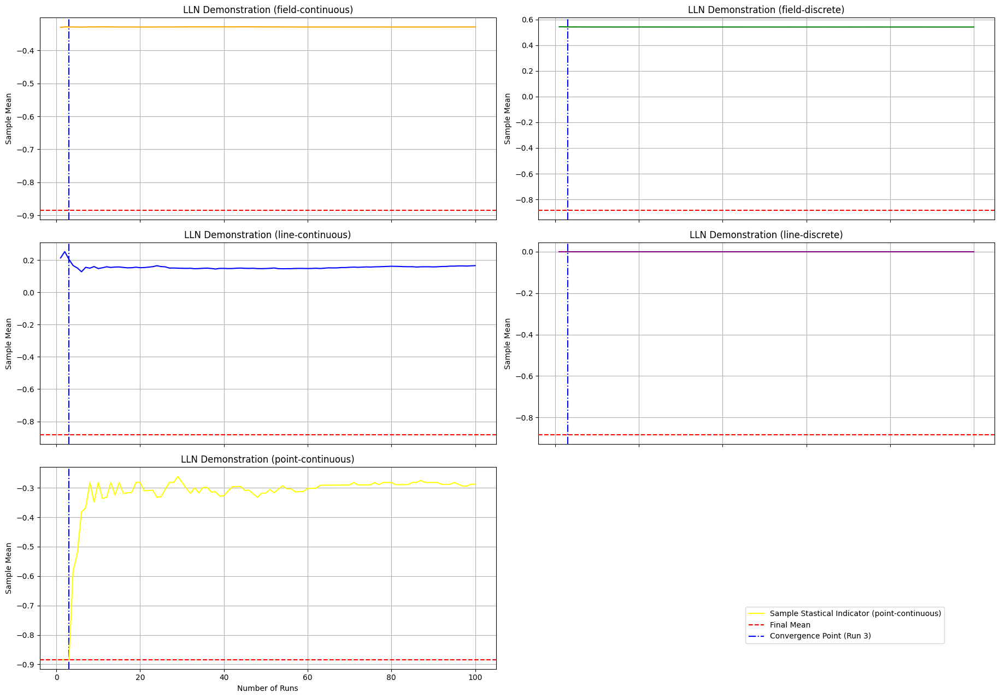

In [194]:
times = 101
threshold = 1e-4
n_states = 5
# 创建一个包含 2x3 网格的图形
fig, axes = plt.subplots(3, 2, figsize=(20, 14))
axhline_colors = ['orange', 'green', 'blue', 'purple', 'yellow', 'brown']  # axhline 不同颜色
scatter_colors = ['lightcoral', 'lightgreen', 'lightblue', 'plum', 'moccasin', 'tan']  # scatter 同色系不同颜色
convergence_point = pd.DataFrame(columns=LLNtype)
previous_mean_array = pd.DataFrame(columns=LLNtype)

dimensionxy = 25
results = []
LLNtype = ["field-continuous", "field-discrete", "line-continuous", "line-discrete", "point-continuous"]

def findScatterxy(row,results):        
    convergence_x = row  # 获取第二行的运行次数
    convergence_y =np.mean(results)
    return convergence_x,convergence_y
        

for idx, type in enumerate(LLNtype):
    results = []
    convergence_point_found = False
    print(type)
    for i_time in range(1, times):
        
        if type == "field-continuous":
            X = np.column_stack([XX.ravel(), YY.ravel()])
            y = B0.ravel()
            X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
            processed_value = process_data_with_randomness_field_continuous(X_train, X_test, y_train, y_test)
            current_mean = np.mean(processed_value)
             
        if type == "field-discrete":
            data = B0.reshape(-1, 1)  # 将数据重塑为一列
            silhouette_avg = process_data_with_randomness_field_discrete(data)
            processed_value = silhouette_score(data, silhouette_avg)  # 计算轮廓系数
            current_mean = processed_value
           
        if type == "line-continuous":
            n_states = 5
            est = KBinsDiscretizer(n_bins=5, encode='ordinal', strategy='uniform')
            B_discretized = est.fit_transform(B0).astype(int)
            processed_value = process_data_with_randomness_line_continuous(B_discretized)
            current_mean = np.mean(processed_value)

        if type == "line-discrete":
            n_states = 5
            est = KBinsDiscretizer(n_bins=n_states, encode='ordinal', strategy='uniform')
            B_discretized = est.fit_transform(B0).astype(int)
            processed_value = process_data_with_randomness_line_discrete(B_discretized)
            current_mean = processed_value     
        
        if type == "point-continuous":
            row_index = 24  # 第25行
            col_index = 9   # 第10列
            est = KBinsDiscretizer(n_bins=5, encode='ordinal', strategy='uniform')
            B_discretized = est.fit_transform(B0)
            processed_value = process_data_with_randomness_point_continuous(B_discretized, row_index, col_index)
            current_mean = np.mean(processed_value)


        
        results.append(current_mean)
        previous_mean_array.loc[i_time, type] = np.mean(results)
        if i_time > 1 and abs(current_mean - np.mean(results)) < threshold and not convergence_point_found:
            print("break",i_time)
            convergence_point[type] = [i_time + 1]  # 第一行为type，第二行为运行次数
            convergence_point_found = True
            convergence_x=i_time + 1
            convergence_y = np.mean(results)

    print("previous_mean_array",convergence_x)

for idx, type in enumerate(LLNtype):  
    # ax.scatter(convergence_x, convergence_y, color=scatter_colors[idx], label=f'Convergence Point (Run {convergence_x})', 
    #                marker='*', s=200, edgecolors='black', linewidths=0.5, zorder=5)

    ax = axes[idx // 2, idx % 2]  # 找到当前子图的位置
    ax.plot(previous_mean_array.index, previous_mean_array[type], label=f'Sample Stastical Indicator ({type})', color=axhline_colors[idx], zorder=3)
    ax.axhline(y=convergence_y, color="r", linestyle='--', label=f'Final Mean', zorder=4)
    ax.axvline(x=convergence_x, color='b', linestyle='-.', linewidth=1.5, label=f'Convergence Point (Run {convergence_x})')

    ax.set_xlabel('Number of Runs')
    ax.set_ylabel('Sample Mean')
    ax.set_title(f'LLN Demonstration ({type})')
    ax.grid(True)
    # 隐藏除最后一行外的所有子图的 x 轴
    if idx // 2 < 2:  # 只有最后一行保留x轴
        ax.set_xlabel('')
        ax.set_xticklabels([])
    else:
        ax.set_xlabel('Number of Runs')

# 将最后一个子图设为空白
axes[-1, -1].axis('off')

# 调整布局和图例位置
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc='lower right', bbox_to_anchor=(0.9, 0.1))

plt.tight_layout(rect=[0.03, 0.03, 0.95, 0.95])
plt.show()


field-continuous
previous_mean_array   field-continuous field-discrete line-continuous line-discrete  \
0               88            NaN             NaN           NaN   
1        -0.329504            NaN             NaN           NaN   

  point-continuous  
0              NaN  
1              NaN  
field-discrete


MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows

previous_mean_array   field-continuous field-discrete line-continuous line-discrete  \
0               88            NaN             NaN           NaN   
1        -0.329504            NaN             NaN           NaN   

  point-continuous  
0              NaN  
1              NaN  
line-continuous
previous_mean_array   field-continuous field-discrete line-continuous line-discrete  \
0               88            NaN             NaN           NaN   
1        -0.329504            NaN             NaN           NaN   

  point-continuous  
0              NaN  
1              NaN  
line-discrete


MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows

previous_mean_array   field-continuous field-discrete line-continuous line-discrete  \
0               88            NaN             NaN           NaN   
1        -0.329504            NaN             NaN           NaN   

  point-continuous  
0              NaN  
1              NaN  
point-continuous
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.8842550909756126
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.8842550909756126
Predicted value for position (24, 9): -0.8842550909756126
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.8842550909756126
Predicted value for position (24, 9): -0.8842550909756126

IndexError: index 1 is out of bounds for axis 0 with size 1

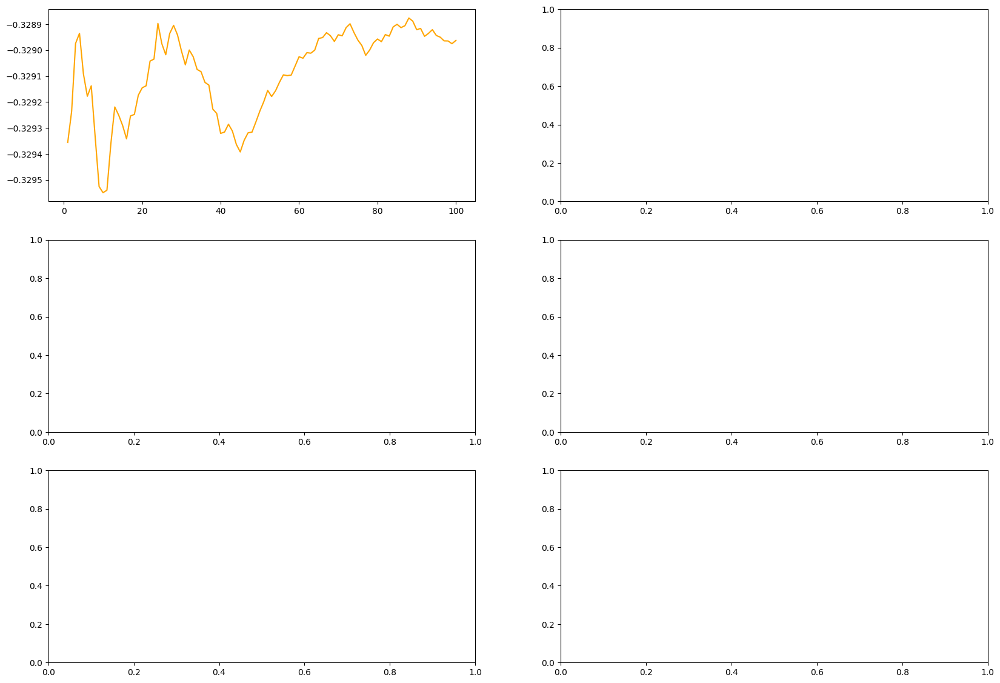

In [247]:
# times = 101
# threshold = 1e-4
# n_states = 5
# # 创建一个包含 2x3 网格的图形
# fig, axes = plt.subplots(3, 2, figsize=(20, 14))
# axhline_colors = ['#e7298a', '#d95f02', '#e6ab02', '#e6ab02', '66a61e', '7570b3']  # axhline 不同颜色
# scatter_colors = ['lightcoral', 'lightgreen', 'lightblue', 'plum', 'moccasin', 'tan']  # scatter 同色系不同颜色
# convergence_point = pd.DataFrame(columns=LLNtype)
# previous_mean_array = pd.DataFrame(columns=LLNtype)
# results = pd.DataFrame(columns=LLNtype)
# dimensionxy = 25

# LLNtype = ["field-continuous", "field-discrete", "line-continuous", "line-discrete", "point-continuous"]
# convergence_xy = pd.DataFrame(columns=LLNtype)

# for idx, type in enumerate(LLNtype):
#     convergence_point_found = False
#     print(type)
#     for i_time in range(1, times):
        
#         if type == "field-continuous":
#             X = np.column_stack([XX.ravel(), YY.ravel()])
#             y = B0.ravel()
#             X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
#             processed_value = process_data_with_randomness_field_continuous(X_train, X_test, y_train, y_test)
#             current_mean = np.mean(processed_value)
             
#         # if type == "field-discrete":
#         #     data = B0.reshape(-1, 1)
#         #     silhouette_avg = process_data_with_randomness_field_discrete(data)
#         #     processed_value = silhouette_score(data, silhouette_avg)
#         #     current_mean = processed_value
           
#         # if type == "line-continuous":
#         #     n_states = 5
#         #     est = KBinsDiscretizer(n_bins=5, encode='ordinal', strategy='uniform')
#         #     B_discretized = est.fit_transform(B0).astype(int)
#         #     processed_value = process_data_with_randomness_line_continuous(B_discretized)
#         #     current_mean = np.mean(processed_value)

#         # if type == "line-discrete":
#         #     n_states = 5
#         #     est = KBinsDiscretizer(n_bins=n_states, encode='ordinal', strategy='uniform')
#         #     B_discretized = est.fit_transform(B0).astype(int)
#         #     processed_value = process_data_with_randomness_line_discrete(B_discretized)
#         #     current_mean = processed_value     
        
#         # if type == "point-continuous":
#         #     row_index = 24  # 第25行
#         #     col_index = 9   # 第10列
#         #     est = KBinsDiscretizer(n_bins=5, encode='ordinal', strategy='uniform')
#         #     B_discretized = est.fit_transform(B0)
#         #     processed_value = process_data_with_randomness_point_continuous(B_discretized, row_index, col_index)
#         #     current_mean = np.mean(processed_value)

#         results.loc[i_time, type] =current_mean # results.append(current_mean) #results记录所有的current_mean
        
#         previous_mean_array.loc[i_time, type] = np.mean(results.loc[:, type])

#         if i_time > 1 and abs(current_mean -  np.mean(results.loc[:, type])) < threshold and not convergence_point_found:
#             print("break", i_time,convergence_xy)
#             convergence_xy.loc[0,type] = i_time
#             convergence_xy.loc[1,type] = np.mean(results.loc[:, type])
#             convergence_point_found=True

#     print("previous_mean_array", convergence_x)

# for idx, type in enumerate(LLNtype):
#     ax = axes[idx // 2, idx % 2]
#     ax.plot(previous_mean_array.index, previous_mean_array[type], label=f'Sample Statistical Indicator ({type})', color=axhline_colors[idx], zorder=3)
#     print("convergence_x is not None and convergence_y ",convergence_x , convergence_y )
#     if convergence_x is not None and convergence_y is not None:
#         print(results.loc[:, type])
#         ax.axhline(convergence_xy.loc[1,type], color="r", linestyle='--', label=f'Final Mean', zorder=4)
#         ax.axvline(x=convergence_xy.loc[0,type], color='b', linestyle='-.', linewidth=1.5, label=f'Convergence Point (Run {convergence_x})')

#     ax.set_xlabel('Number of Runs')
#     ax.set_ylabel('Sample Mean')
#     ax.set_title(f'LLN Demonstration ({type})')
#     ax.grid(True)

#     if idx // 2 < 2:
#         ax.set_xlabel('')
#         ax.set_xticklabels([])
#     else:
#         ax.set_xlabel('Number of Runs')

# # 将最后一个子图设为空白
# axes[-1, -1].axis('off')

# # 调整布局和图例位置
# handles, labels = ax.get_legend_handles_labels()
# fig.legend(handles, labels, loc='lower right', bbox_to_anchor=(0.9, 0.1))

# plt.tight_layout(rect=[0.03, 0.03, 0.95, 0.95])
# plt.show()

In [ ]:
times = 10001

n_states = 5
# 创建一个包含 2x3 网格的图形
fig, axes = plt.subplots(3, 2, figsize=(20, 14))
axhline_colors = [ '#e31a1c','#1f78b4', '#33a02c', '#ff7f00', '#6a3d9a', '#b15928',]  # axhline 不同颜色
scatter_colors = [ '#fb9a99','#a6cee3', '#b2df8a', '#fdbf6f', '#cab2d6', '#ffff99',]  # scatter 同色系不同颜色
convergence_point = pd.DataFrame(columns=LLNtype)
previous_mean_array = pd.DataFrame(columns=LLNtype)
results = pd.DataFrame(columns=LLNtype)
dimensionxy = 25

field-continuous
field-discrete
line-continuous


MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows

line-discrete


MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows

point-continuous
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.8842550909756126
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.8842550909756126
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250

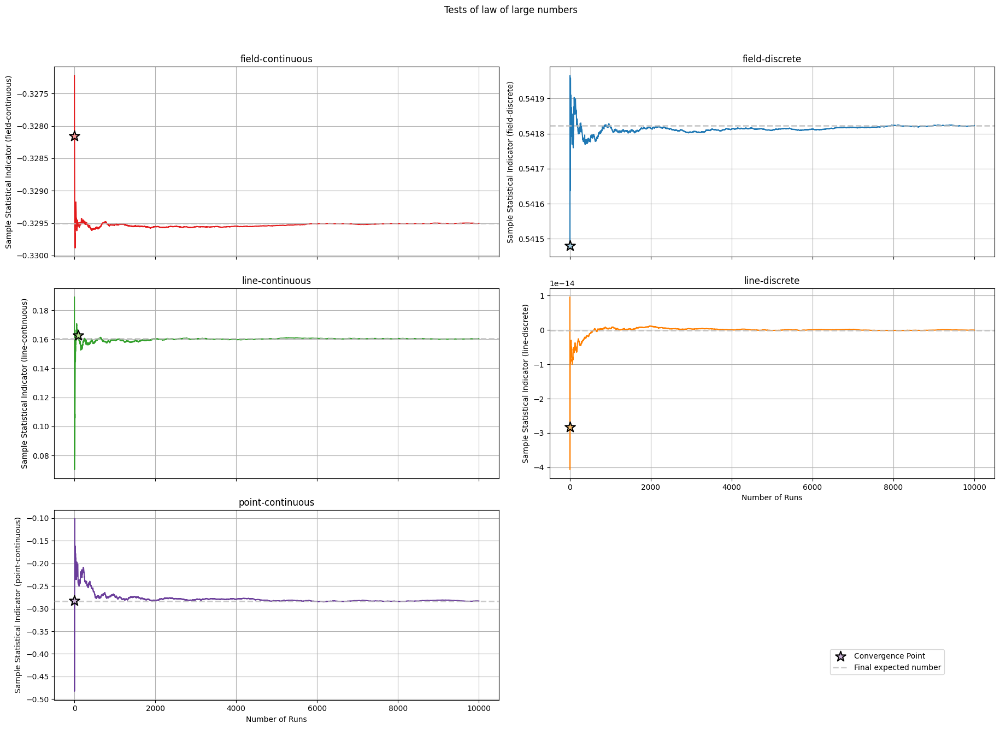

In [279]:
times = 10001

n_states = 5
# 创建一个包含 2x3 网格的图形
fig, axes = plt.subplots(3, 2, figsize=(20, 14))
axhline_colors = [ '#e31a1c','#1f78b4', '#33a02c', '#ff7f00', '#6a3d9a', '#b15928',]  # axhline 不同颜色
scatter_colors = [ '#fb9a99','#a6cee3', '#b2df8a', '#fdbf6f', '#cab2d6', '#ffff99',]  # scatter 同色系不同颜色
convergence_point = pd.DataFrame(columns=LLNtype)
previous_mean_array = pd.DataFrame(columns=LLNtype)
results = pd.DataFrame(columns=LLNtype)
dimensionxy = 25

LLNtype = ["field-continuous", "field-discrete", "line-continuous", "line-discrete", "point-continuous"]
convergence_xy = pd.DataFrame(columns=LLNtype)

for idx, type in enumerate(LLNtype):
    convergence_point_found = False
    print(type)
    for i_time in range(1, times):
        if type == "field-continuous":
            threshold = 1e-5
            X = np.column_stack([XX.ravel(), YY.ravel()])
            y = B0.ravel()
            X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
            processed_value = process_data_with_randomness_field_continuous(X_train, X_test, y_train, y_test)
            current_mean = np.mean(processed_value)
             
        if type == "field-discrete":
            threshold = 1e-5
            data = B0.reshape(-1, 1)
            silhouette_avg = process_data_with_randomness_field_discrete(data)
            processed_value = silhouette_score(data, silhouette_avg)
            current_mean = processed_value
           
        if type == "line-continuous":
            threshold = 1e-3
            n_states = 5
            est = KBinsDiscretizer(n_bins=5, encode='ordinal', strategy='uniform')
            B_discretized = est.fit_transform(B0).astype(int)
            processed_value = process_data_with_randomness_line_continuous(B_discretized)
            current_mean = np.mean(processed_value)

        if type == "line-discrete":
            threshold = 1e-7
            n_states = 5
            est = KBinsDiscretizer(n_bins=n_states, encode='ordinal', strategy='uniform')
            B_discretized = est.fit_transform(B0).astype(int)
            processed_value = process_data_with_randomness_line_discrete(B_discretized)
            current_mean = processed_value     
        
        if type == "point-continuous":
            threshold = 1e-6
            row_index = 24  # 第25行
            col_index = 9   # 第10列
            est = KBinsDiscretizer(n_bins=5, encode='ordinal', strategy='uniform')
            B_discretized = est.fit_transform(B0)
            processed_value = process_data_with_randomness_point_continuous(B_discretized, row_index, col_index)
            current_mean = np.mean(processed_value)

        results.loc[i_time, type] =current_mean # results.append(current_mean) #results记录所有的current_mean
        
        previous_mean_array.loc[i_time, type] = np.mean(results.loc[:, type])

        if i_time > 1 and abs(current_mean -  np.mean(results.loc[:, type])) < threshold and not convergence_point_found:
            convergence_xy.loc[0,type] = i_time
            convergence_xy.loc[1,type] = np.mean(results.loc[:, type])
            convergence_point_found=True
for idx, type in enumerate(LLNtype):
    ax = axes[idx // 2, idx % 2]
    ax.plot(previous_mean_array.index, previous_mean_array[type], color=axhline_colors[idx], zorder=3)
    x_value = convergence_xy.iloc[0, convergence_xy.columns.get_loc(type)]
    y_value = convergence_xy.iloc[1, convergence_xy.columns.get_loc(type)]

    if pd.notnull(x_value) and pd.notnull(y_value):
        ax.scatter(x_value, y_value,  label=f'Convergence Point', 
                   marker='*', s=200, edgecolors='black', linewidths=1.5, zorder=5,color=scatter_colors[idx])
        # ax.axhline(y_value, color="r", linestyle='--', label=f'Final Mean', zorder=4)
        # ax.axvline(x_value, color='b', linestyle='-.', linewidth=1.5, label=f'Convergence Point (Run {convergence_x})')
    ax.axhline(np.mean(previous_mean_array.loc[i_time, type]), linewidth=2,color="#bdbdbd", linestyle='--', label=f'Final expected number', zorder=4,alpha=0.8)
    ax.set_xlabel('Number of Runs')
    ax.set_ylabel(f'Sample Statistical Indicator ({type})')
    ax.set_title(f'{type}')
    
    ax.grid(True)

    if idx  < 3:
        ax.set_xlabel('')
        ax.set_xticklabels([])
    else:
        ax.set_xlabel('Number of Runs')

# 将最后一个子图设为空白
axes[-1, -1].axis('off')

# 调整布局和图例位置
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc='lower right', bbox_to_anchor=(0.9, 0.1))

plt.suptitle("Tests of law of large numbers")
plt.tight_layout(rect=[0.03, 0.03, 0.95, 0.95])
plt.show()

field-continuous
field-discrete
line-continuous


MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows

line-discrete


MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows

point-continuous
Predicted value for position (24, 9): -0.8842550909756126
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): -0.8842550909756126
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): -0.8842550909756126
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971

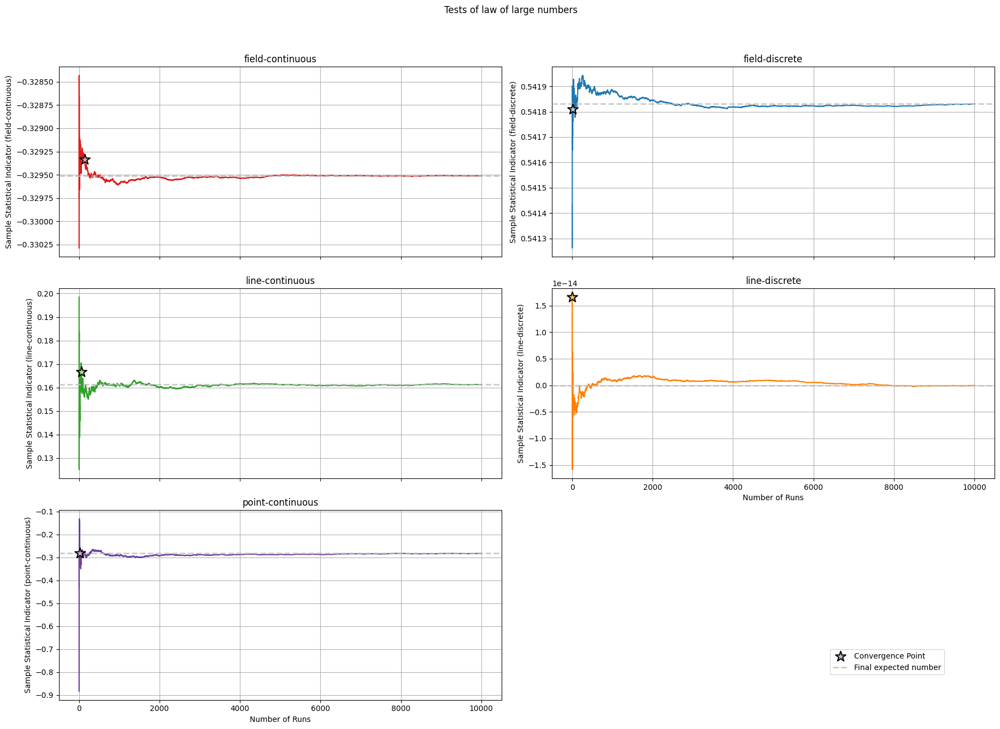

In [280]:
times = 10001

n_states = 5
# 创建一个包含 2x3 网格的图形
fig, axes = plt.subplots(3, 2, figsize=(20, 14))
axhline_colors = [ '#e31a1c','#1f78b4', '#33a02c', '#ff7f00', '#6a3d9a', '#b15928',]  # axhline 不同颜色
scatter_colors = [ '#fb9a99','#a6cee3', '#b2df8a', '#fdbf6f', '#cab2d6', '#ffff99',]  # scatter 同色系不同颜色
convergence_point = pd.DataFrame(columns=LLNtype)
previous_mean_array = pd.DataFrame(columns=LLNtype)
results = pd.DataFrame(columns=LLNtype)
dimensionxy = 25

LLNtype = ["field-continuous", "field-discrete", "line-continuous", "line-discrete", "point-continuous"]
convergence_xy = pd.DataFrame(columns=LLNtype)

for idx, type in enumerate(LLNtype):
    convergence_point_found = False
    print(type)
    for i_time in range(1, times):
        if type == "field-continuous":
            threshold = 1e-5
            X = np.column_stack([XX.ravel(), YY.ravel()])
            y = B0.ravel()
            X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
            processed_value = process_data_with_randomness_field_continuous(X_train, X_test, y_train, y_test)
            current_mean = np.mean(processed_value)
             
        if type == "field-discrete":
            threshold = 1e-5*2
            data = B0.reshape(-1, 1)
            silhouette_avg = process_data_with_randomness_field_discrete(data)
            processed_value = silhouette_score(data, silhouette_avg)
            current_mean = processed_value
           
        if type == "line-continuous":
            threshold = 1e-3
            n_states = 5
            est = KBinsDiscretizer(n_bins=5, encode='ordinal', strategy='uniform')
            B_discretized = est.fit_transform(B0).astype(int)
            processed_value = process_data_with_randomness_line_continuous(B_discretized)
            current_mean = np.mean(processed_value)

        if type == "line-discrete":
            threshold = 1e-7
            n_states = 5
            est = KBinsDiscretizer(n_bins=n_states, encode='ordinal', strategy='uniform')
            B_discretized = est.fit_transform(B0).astype(int)
            processed_value = process_data_with_randomness_line_discrete(B_discretized)
            current_mean = processed_value     
        
        if type == "point-continuous":
            threshold = 1e-6
            row_index = 24  # 第25行
            col_index = 9   # 第10列
            est = KBinsDiscretizer(n_bins=5, encode='ordinal', strategy='uniform')
            B_discretized = est.fit_transform(B0)
            processed_value = process_data_with_randomness_point_continuous(B_discretized, row_index, col_index)
            current_mean = np.mean(processed_value)

        results.loc[i_time, type] =current_mean # results.append(current_mean) #results记录所有的current_mean
        
        previous_mean_array.loc[i_time, type] = np.mean(results.loc[:, type])

        if i_time > 1 and abs(current_mean -  np.mean(results.loc[:, type])) < threshold and not convergence_point_found:
            convergence_xy.loc[0,type] = i_time
            convergence_xy.loc[1,type] = np.mean(results.loc[:, type])
            convergence_point_found=True
for idx, type in enumerate(LLNtype):
    ax = axes[idx // 2, idx % 2]
    ax.plot(previous_mean_array.index, previous_mean_array[type], color=axhline_colors[idx], zorder=3)
    x_value = convergence_xy.iloc[0, convergence_xy.columns.get_loc(type)]
    y_value = convergence_xy.iloc[1, convergence_xy.columns.get_loc(type)]

    if pd.notnull(x_value) and pd.notnull(y_value):
        ax.scatter(x_value, y_value,  label=f'Convergence Point', 
                   marker='*', s=200, edgecolors='black', linewidths=1.5, zorder=5,color=scatter_colors[idx])
        # ax.axhline(y_value, color="r", linestyle='--', label=f'Final Mean', zorder=4)
        # ax.axvline(x_value, color='b', linestyle='-.', linewidth=1.5, label=f'Convergence Point (Run {convergence_x})')
    ax.axhline(np.mean(previous_mean_array.loc[i_time, type]), linewidth=2,color="#bdbdbd", linestyle='--', label=f'Final expected number', zorder=4,alpha=0.8)
    ax.set_xlabel('Number of Runs')
    ax.set_ylabel(f'Sample Statistical Indicator ({type})')
    ax.set_title(f'{type}')
    
    ax.grid(True)

    if idx  < 3:
        ax.set_xlabel('')
        ax.set_xticklabels([])
    else:
        ax.set_xlabel('Number of Runs')

# 将最后一个子图设为空白
axes[-1, -1].axis('off')

# 调整布局和图例位置
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc='lower right', bbox_to_anchor=(0.9, 0.1))

plt.suptitle("Tests of law of large numbers")
plt.tight_layout(rect=[0.03, 0.03, 0.95, 0.95])
plt.show()

field-continuous
field-discrete
line-continuous


MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows

line-discrete


MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows

point-continuous
Predicted value for position (24, 9): -0.8842550909756126
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): -0.8842550909756126
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): 0.3205100

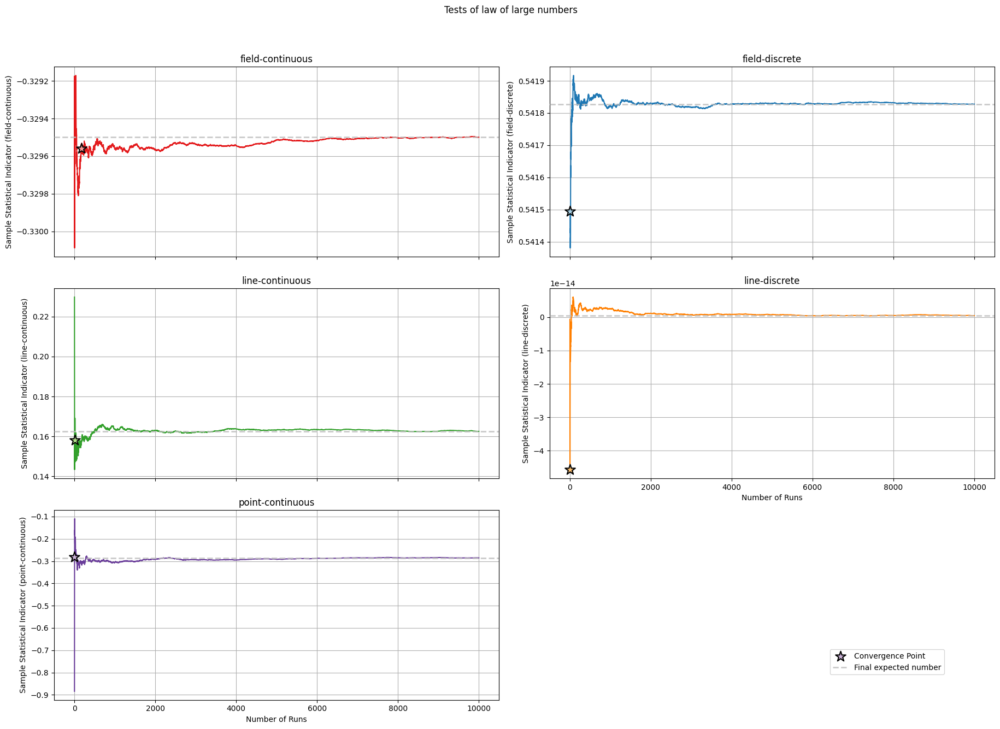

In [281]:
times = 10001

n_states = 5
# 创建一个包含 2x3 网格的图形
fig, axes = plt.subplots(3, 2, figsize=(20, 14))
axhline_colors = [ '#e31a1c','#1f78b4', '#33a02c', '#ff7f00', '#6a3d9a', '#b15928',]  # axhline 不同颜色
scatter_colors = [ '#fb9a99','#a6cee3', '#b2df8a', '#fdbf6f', '#cab2d6', '#ffff99',]  # scatter 同色系不同颜色
convergence_point = pd.DataFrame(columns=LLNtype)
previous_mean_array = pd.DataFrame(columns=LLNtype)
results = pd.DataFrame(columns=LLNtype)
dimensionxy = 25

LLNtype = ["field-continuous", "field-discrete", "line-continuous", "line-discrete", "point-continuous"]
convergence_xy = pd.DataFrame(columns=LLNtype)

for idx, type in enumerate(LLNtype):
    convergence_point_found = False
    print(type)
    for i_time in range(1, times):
        if type == "field-continuous":
            threshold = 1e-5
            X = np.column_stack([XX.ravel(), YY.ravel()])
            y = B0.ravel()
            X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
            processed_value = process_data_with_randomness_field_continuous(X_train, X_test, y_train, y_test)
            current_mean = np.mean(processed_value)
             
        if type == "field-discrete":
            threshold = 1e-5*2
            data = B0.reshape(-1, 1)
            silhouette_avg = process_data_with_randomness_field_discrete(data)
            processed_value = silhouette_score(data, silhouette_avg)
            current_mean = processed_value
           
        if type == "line-continuous":
            threshold = 1e-3
            n_states = 5
            est = KBinsDiscretizer(n_bins=5, encode='ordinal', strategy='uniform')
            B_discretized = est.fit_transform(B0).astype(int)
            processed_value = process_data_with_randomness_line_continuous(B_discretized)
            current_mean = np.mean(processed_value)

        if type == "line-discrete":
            threshold = 1e-8
            n_states = 5
            est = KBinsDiscretizer(n_bins=n_states, encode='ordinal', strategy='uniform')
            B_discretized = est.fit_transform(B0).astype(int)
            processed_value = process_data_with_randomness_line_discrete(B_discretized)
            current_mean = processed_value     
        
        if type == "point-continuous":
            threshold = 1e-6
            row_index = 24  # 第25行
            col_index = 9   # 第10列
            est = KBinsDiscretizer(n_bins=5, encode='ordinal', strategy='uniform')
            B_discretized = est.fit_transform(B0)
            processed_value = process_data_with_randomness_point_continuous(B_discretized, row_index, col_index)
            current_mean = np.mean(processed_value)

        results.loc[i_time, type] =current_mean # results.append(current_mean) #results记录所有的current_mean
        
        previous_mean_array.loc[i_time, type] = np.mean(results.loc[:, type])

        if i_time > 1 and abs(current_mean -  np.mean(results.loc[:, type])) < threshold and not convergence_point_found:
            convergence_xy.loc[0,type] = i_time
            convergence_xy.loc[1,type] = np.mean(results.loc[:, type])
            convergence_point_found=True
for idx, type in enumerate(LLNtype):
    ax = axes[idx // 2, idx % 2]
    ax.plot(previous_mean_array.index, previous_mean_array[type], color=axhline_colors[idx], zorder=3)
    x_value = convergence_xy.iloc[0, convergence_xy.columns.get_loc(type)]
    y_value = convergence_xy.iloc[1, convergence_xy.columns.get_loc(type)]

    if pd.notnull(x_value) and pd.notnull(y_value):
        ax.scatter(x_value, y_value,  label=f'Convergence Point', 
                   marker='*', s=200, edgecolors='black', linewidths=1.5, zorder=5,color=scatter_colors[idx])
        # ax.axhline(y_value, color="r", linestyle='--', label=f'Final Mean', zorder=4)
        # ax.axvline(x_value, color='b', linestyle='-.', linewidth=1.5, label=f'Convergence Point (Run {convergence_x})')
    ax.axhline(np.mean(previous_mean_array.loc[i_time, type]), linewidth=2,color="#bdbdbd", linestyle='--', label=f'Final expected number', zorder=4,alpha=0.8)
    ax.set_xlabel('Number of Runs')
    ax.set_ylabel(f'Sample Statistical Indicator ({type})')
    ax.set_title(f'{type}')
    
    ax.grid(True)

    if idx  < 3:
        ax.set_xlabel('')
        ax.set_xticklabels([])
    else:
        ax.set_xlabel('Number of Runs')

# 将最后一个子图设为空白
axes[-1, -1].axis('off')

# 调整布局和图例位置
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc='lower right', bbox_to_anchor=(0.9, 0.1))

plt.suptitle("Tests of law of large numbers")
plt.tight_layout(rect=[0.03, 0.03, 0.95, 0.95])
plt.show()

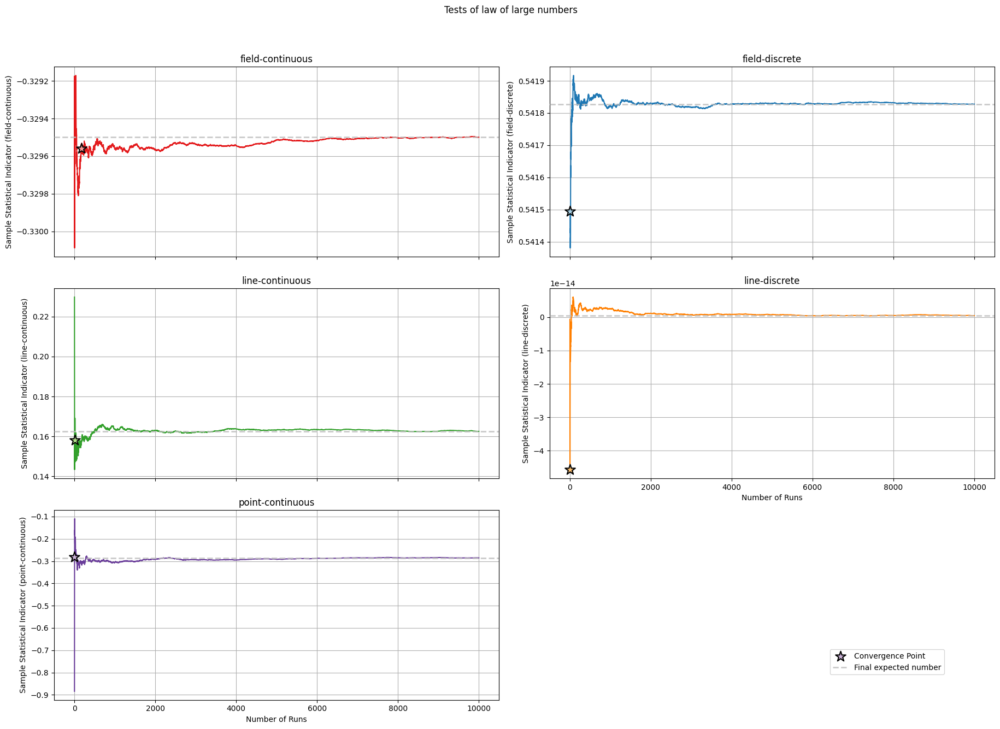

field-continuous
field-discrete
line-continuous


MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows

line-discrete


MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows the standard definition for a Multinomial distribution (e.g. as in https://en.wikipedia.org/wiki/Multinomial_distribution). See these issues for details:
https://github.com/hmmlearn/hmmlearn/issues/335
https://github.com/hmmlearn/hmmlearn/issues/340
MultinomialHMM has undergone major changes. The previous version was implementing a CategoricalHMM (a special case of MultinomialHMM). This new implementation follows

point-continuous
Predicted value for position (24, 9): -0.8842550909756126
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): 0.3205100715481153
Predicted value for position (24, 9): -0.8842550909756126
Predicted value for position (24, 9): -0.28187250971374866
Predicted value for position (24, 9): -0.8842550909756126
Predicted value for position (24, 9): -0.8842550909756126
Predicted value for position (24, 9): -0.281872509713

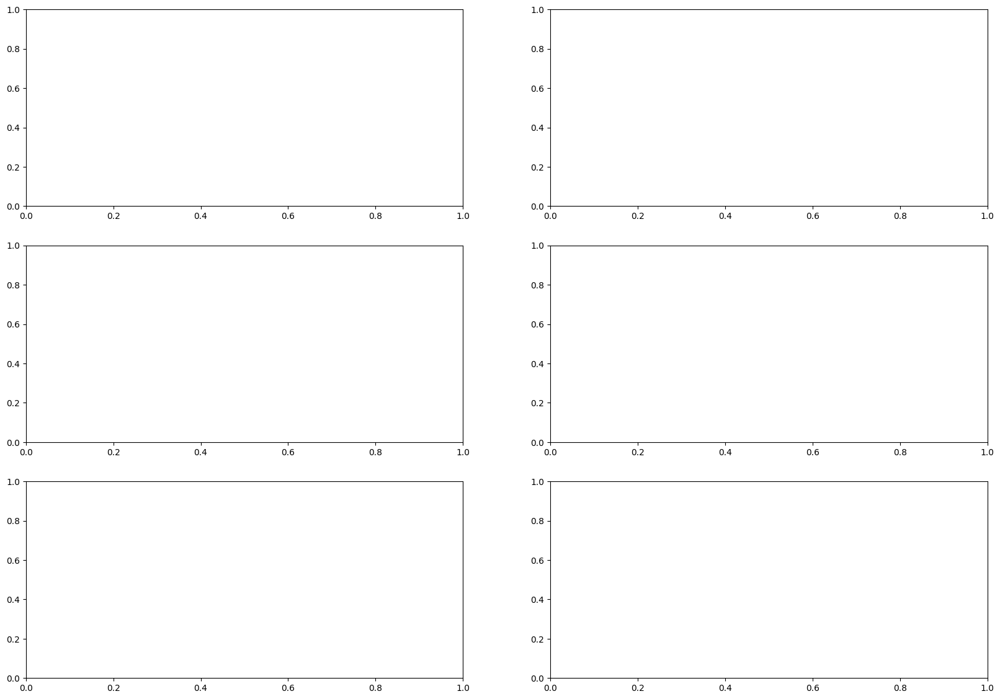

In [288]:
times = 10001

n_states = 5
# 创建一个包含 2x3 网格的图形
fig, axes = plt.subplots(3, 2, figsize=(20, 14))
axhline_colors = [ '#e31a1c','#1f78b4', '#33a02c', '#ff7f00', '#6a3d9a', '#b15928',]  # axhline 不同颜色
scatter_colors = [ '#fb9a99','#a6cee3', '#b2df8a', '#fdbf6f', '#cab2d6', '#ffff99',]  # scatter 同色系不同颜色
convergence_point = pd.DataFrame(columns=LLNtype)
previous_mean_array = pd.DataFrame(columns=LLNtype)
results = pd.DataFrame(columns=LLNtype)
dimensionxy = 25

LLNtype = ["field-continuous", "field-discrete", "line-continuous", "line-discrete", "point-continuous"]
convergence_xy = pd.DataFrame(columns=LLNtype)

for idx, type in enumerate(LLNtype):
    convergence_point_found = False
    print(type)
    for i_time in range(1, times):
        if type == "field-continuous":
            threshold = 1e-5
            X = np.column_stack([XX.ravel(), YY.ravel()])
            y = B0.ravel()
            X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)
            processed_value = process_data_with_randomness_field_continuous(X_train, X_test, y_train, y_test)
            current_mean = np.mean(processed_value)
             
        if type == "field-discrete":
            threshold = 1e-5
            data = B0.reshape(-1, 1)
            silhouette_avg = process_data_with_randomness_field_discrete(data)
            processed_value = silhouette_score(data, silhouette_avg)
            current_mean = processed_value
           
        if type == "line-continuous":
            threshold = 1e-3
            n_states = 5
            est = KBinsDiscretizer(n_bins=5, encode='ordinal', strategy='uniform')
            B_discretized = est.fit_transform(B0).astype(int)
            processed_value = process_data_with_randomness_line_continuous(B_discretized)
            current_mean = np.mean(processed_value)

        if type == "line-discrete":
            threshold = 1e-14
            n_states = 5
            est = KBinsDiscretizer(n_bins=n_states, encode='ordinal', strategy='uniform')
            B_discretized = est.fit_transform(B0).astype(int)
            processed_value = process_data_with_randomness_line_discrete(B_discretized)
            current_mean = processed_value     
        
        if type == "point-continuous":
            threshold = 1e-6
            row_index = 24  # 第25行
            col_index = 9   # 第10列
            est = KBinsDiscretizer(n_bins=5, encode='ordinal', strategy='uniform')
            B_discretized = est.fit_transform(B0)
            processed_value = process_data_with_randomness_point_continuous(B_discretized, row_index, col_index)
            current_mean = np.mean(processed_value)

        results.loc[i_time, type] =current_mean # results.append(current_mean) #results记录所有的current_mean
        
        previous_mean_array.loc[i_time, type] = np.mean(results.loc[:, type])

        if i_time > 1 and abs(current_mean -  np.mean(results.loc[:, type])) < threshold and not convergence_point_found:
            convergence_xy.loc[0,type] = i_time
            convergence_xy.loc[1,type] = np.mean(results.loc[:, type])
            convergence_point_found=True


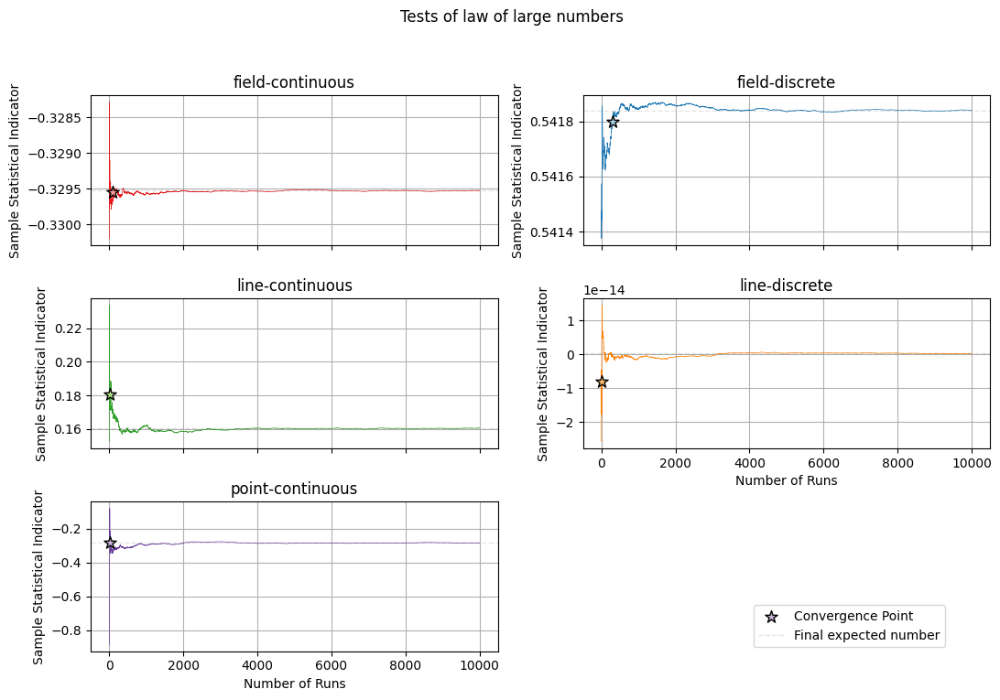

In [302]:
# 创建一个包含 2x3 网格的图形
fig, axes = plt.subplots(3, 2, figsize=(12, 8))

for idx, type in enumerate(LLNtype):
    ax = axes[idx // 2, idx % 2]
    ax.plot(previous_mean_array.index, previous_mean_array[type], color=axhline_colors[idx], zorder=3,linewidth=0.5)
    x_value = convergence_xy.iloc[0, convergence_xy.columns.get_loc(type)]
    y_value = convergence_xy.iloc[1, convergence_xy.columns.get_loc(type)]

    if pd.notnull(x_value) and pd.notnull(y_value):
        ax.scatter(x_value, y_value,  label=f'Convergence Point', 
                   marker='*', s=100, edgecolors='black', linewidths=1, zorder=5,color=scatter_colors[idx])
        # ax.axhline(y_value, color="r", linestyle='--', label=f'Final Mean', zorder=4)
        # ax.axvline(x_value, color='b', linestyle='-.', linewidth=1.5, label=f'Convergence Point (Run {convergence_x})')
    ax.axhline(np.mean(previous_mean_array.loc[i_time, type]), linewidth=1,color="black", linestyle='--', label=f'Final expected number', zorder=4,alpha=0.1)
    ax.set_xlabel('Number of Runs')
    ax.set_ylabel(f'Sample Statistical Indicator')
    ax.set_title(f'{type}')
    
    ax.grid(True)

    if idx  < 3:
        ax.set_xlabel('')
        ax.set_xticklabels([])
    else:
        ax.set_xlabel('Number of Runs')

# 将最后一个子图设为空白
axes[-1, -1].axis('off')

# 调整布局和图例位置
handles, labels = ax.get_legend_handles_labels()
fig.legend(handles, labels, loc='lower right', bbox_to_anchor=(0.9, 0.1))

plt.suptitle("Tests of law of large numbers")
plt.tight_layout(rect=[0.03, 0.03, 0.95, 0.95])
plt.show()